## Public Bike Parking in Dublin City

### *Import mandatory libraries*

In [1]:
# libraries for manipulating data
import pandas as pd
import numpy as np

# libraries for visualising data
import matplotlib.pyplot as plt
import seaborn as sns

# Suppress warning messages
import warnings
warnings.filterwarnings("ignore")

### 1. Data preparation

#### 1.1 Overview of original dataset

In [2]:
# Read original dataset and display the top 5 rows
bikeparking = pd.read_csv("dublin_bike_parking.csv", encoding = "latin1")
bikeparking.head()

,type_stands,X,Y,Easting,Northing,location_stand,no_stands
0,Sheffield Stand,-6.227261,53.34779261,318106.414,234502.185,East wall road outside the O2,4.0
1,Sheffield Stand,-6.265139,53.33424783,315620.753,232932.916,"Camden street lower, outside centra shop",1.0
2,Sheffield Stand,-6.249766,53.34494805,316615.570,234148.652,Marks lane,2.0
3,Sheffield Stand,-6.251052,53.34851312,316520.200,234543.281,"Custom House Quay, outside AIB International C...",1.0
4,Sheffield Stand,-6.242273,53.34296483,317119.980,233940.217,Pearce street outside garden area,3.0


In [3]:
# View the basic information
bikeparking.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 937 entries, 0 to 936
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   type_stands     937 non-null    object 
 1   X               688 non-null    float64
 2   Y               688 non-null    object 
 3   Easting         937 non-null    float64
 4   Northing        937 non-null    float64
 5   location_stand  890 non-null    object 
 6   no_stands       888 non-null    float64
dtypes: float64(4), object(3)
memory usage: 51.4+ KB


In [4]:
# Display the data type of each feature
bikeparking.dtypes

type_stands        object
X                 float64
Y                  object
Easting           float64
Northing          float64
location_stand     object
no_stands         float64
dtype: object

In [5]:
# Check shape of the data: numbers of rows and columns (i.e. numbers of observations and features)
bikeparking.shape

(937, 7)

In [6]:
# Check the unique values of type_stands: 7 types of bike parking stands showed
bikeparking["type_stands"].unique()

array(['Sheffield Stand', 'Railing', 'Stainless Steel Curved', 'Hoops',
       'Temporary Racks', 'Cargo bike stands',
       'Sheffield Stand +Cargo Stand'], dtype=object)

In [7]:
# Check if there are duplicates
bikeparking.duplicated().sum()

0

In [8]:
# Check the overall missing values in each column to gain insights for data cleaning
bikeparking.isnull().sum()

type_stands         0
X                 249
Y                 249
Easting             0
Northing            0
location_stand     47
no_stands          49
dtype: int64

### *Coordinate Reference System* 

- **Install pyproj for handling geographic data.**

In [9]:
pip install pyproj 

Note: you may need to restart the kernel to use updated packages.


In [10]:
# Create variables for the three coordinate reference systems found in data
from pyproj import CRS
crs_4326 = CRS.from_epsg(4326)
crs_29902 = CRS.from_epsg(29902)
crs_2157 = CRS.from_epsg(2157)

In [11]:
# a geographic coordinate system: longitude/latitude
crs_4326

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [12]:
# a projected coordinate system (easting/northing)
crs_29902

<Derived Projected CRS: EPSG:29902>
Name: TM65 / Irish Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Ireland - onshore.
- bounds: (-10.56, 51.39, -5.93, 55.43)
Coordinate Operation:
- name: Irish Grid
- method: Transverse Mercator
Datum: TM65
- Ellipsoid: Airy Modified 1849
- Prime Meridian: Greenwich

In [13]:
# a projected coordinate system (itm x/itm y)
crs_2157

<Derived Projected CRS: EPSG:2157>
Name: IRENET95 / Irish Transverse Mercator
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Ireland - onshore. United Kingdom (UK) - Northern Ireland (Ulster) - onshore.
- bounds: (-10.56, 51.39, -5.34, 55.43)
Coordinate Operation:
- name: Irish Transverse Mercator
- method: Transverse Mercator
Datum: IRENET95
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

#### 1.2 Data cleaning

In [14]:
# Observe the unique values of feature X in detail and some problems were found
bikeparking["X"].unique()

array([-6.22726053e+00, -6.26513869e+00, -6.24976561e+00, -6.25105172e+00,
       -6.24227285e+00, -6.26208097e+00, -6.25176385e+00, -6.26816019e+00,
       -6.26436353e+00, -6.26250476e+00, -6.27133861e+00, -6.24598637e+00,
       -6.26279712e+00, -6.25826081e+00, -6.26447484e+00, -6.25979438e+00,
       -6.26552224e+00, -6.26428306e+00, -6.25272408e+00, -6.26881465e+00,
       -6.25044554e+00, -6.25876308e+00, -6.25742063e+00, -6.24954298e+00,
       -6.25900313e+00, -6.26837343e+00, -6.25231504e+00, -6.26864299e+00,
       -6.26110598e+00, -6.25708803e+00, -6.26149356e+00, -6.25499457e+00,
       -6.22892216e+00, -6.25869334e+00, -6.26347706e+00, -6.26712218e+00,
       -6.26449227e+00, -6.26317933e+00, -6.26607746e+00, -6.27217278e+00,
       -6.27538338e+00, -6.24877051e+00, -6.24781027e+00, -6.25508174e+00,
       -6.24988094e+00, -6.24509454e+00, -6.26622498e+00, -6.26945972e+00,
       -6.26893401e+00, -6.25719801e+00, -6.26480877e+00, -6.26795232e+00,
       -6.26986876e+00, -

In [15]:
# Observe the unique values of feature Y in detail and same problems were found
# The values are string type
bikeparking["Y"].unique()

array(['53.34779261', '53.33424783', '53.34494805', '53.34851312',
       '53.34296483', '53.34817688', '53.35182974', '53.35686542',
       '53.35398625', '53.34211451', '53.35055212', '53.33485887',
       '53.33769129', '53.35392471', '53.3509772', '53.35342112',
       '53.33630513', '53.34393043', '53.33299531', '53.34846989',
       '53.341293', '53.33366002', '53.34867644', '53.35221799',
       '53.35921696', '53.35274391', '53.35165203', '53.35275832',
       '53.35264945', '53.35410392', '53.33916468', '53.34695679',
       '53.34845548', '53.35708473', '53.34307452', '53.34103437',
       '53.34339079', '53.34308013', '53.3471065', '53.34126417',
       '53.34595443', '53.33677519', '53.33588071', '53.34158766',
       '53.34336116', '53.34337317', '53.33866101', '53.35013744',
       '53.35202907', '53.35419437', '53.3508299', '53.348618',
       '53.35896725', '53.34900307', '53.34960348', '53.34371105',
       '53.3400639', '53.34383275', '53.34522827', '53.34989648',
   

In [16]:
# Get some understandings of location_stand to make further decision
print(len(bikeparking["location_stand"].unique()))
print(bikeparking["location_stand"].duplicated().sum())
print(bikeparking["location_stand"].isnull().sum())

858
79
47


In [17]:
# Drop the three columns below based on adequate analysis 
# Create a new dataframe bp for further processing
bp = bikeparking.drop(columns = {"X", "Y", "location_stand"})
bp.head()

,type_stands,Easting,Northing,no_stands
0,Sheffield Stand,318106.414,234502.185,4.0
1,Sheffield Stand,315620.753,232932.916,1.0
2,Sheffield Stand,316615.570,234148.652,2.0
3,Sheffield Stand,316520.200,234543.281,1.0
4,Sheffield Stand,317119.980,233940.217,3.0


In [18]:
# Check shape after
bp.shape

(937, 4)

In [19]:
# Check duplicates
bp.duplicated().sum()

1

- ***Interestingly, one duplicate is then detected after dropping some columns. Further explaination is given in the report.***

In [20]:
# Check what is duplicating and find reason
duplicate_bool = bp.duplicated(subset = ["type_stands", "Easting", "Northing", "no_stands"], keep = "first")
duplicate = bp.loc[duplicate_bool == True]
duplicate

,type_stands,Easting,Northing,no_stands
922,Sheffield Stand,312150.0,233511.0,5.0


In [21]:
# Drop the duplicate
bp.drop_duplicates(keep = "first", inplace = True)

In [22]:
# Convert projected coordinates (easting/northing) into geographic coordinates (longtitude/latitude)
# Add two new columns to dataframe bp with the converted coordinate values
# Print and show the updated dataset
from pyproj import Transformer
easting = bp["Easting"].values
northing = bp["Northing"].values
proj = Transformer.from_crs(crs_29902, crs_4326, always_xy=True)
def coordinate_convert(bp):
    long, lat = proj.transform(easting, northing)
    bp["longitude"] = long
    bp["latitude"] = lat
    return bp
print(coordinate_convert(bp))

         type_stands     Easting    Northing  no_stands  longitude   latitude
0    Sheffield Stand  318106.414  234502.185        4.0  -6.227256  53.347793
1    Sheffield Stand  315620.753  232932.916        1.0  -6.265134  53.334248
2    Sheffield Stand  316615.570  234148.652        2.0  -6.249761  53.344949
3    Sheffield Stand  316520.200  234543.281        1.0  -6.251047  53.348514
4    Sheffield Stand  317119.980  233940.217        3.0  -6.242268  53.342965
..               ...         ...         ...        ...        ...        ...
932  Sheffield Stand  316302.000  233262.000        4.0  -6.254792  53.337055
933  Sheffield Stand  315695.000  238310.000       10.0  -6.262055  53.382523
934  Sheffield Stand  314313.000  234658.000        4.0  -6.284133  53.350025
935  Sheffield Stand  309975.000  233713.000        5.0  -6.349573  53.342457
936  Sheffield Stand  313622.000  233003.000        5.0  -6.295098  53.335310

[936 rows x 6 columns]


#### 1.3 Data rearranging

In [23]:
# Create a new dataframe bp1 with the last generated dataset for rearranging and further preparation
bp1 = coordinate_convert(bp)
bp1.head()

,type_stands,Easting,Northing,no_stands,longitude,latitude
0,Sheffield Stand,318106.414,234502.185,4.0,-6.227256,53.347793
1,Sheffield Stand,315620.753,232932.916,1.0,-6.265134,53.334248
2,Sheffield Stand,316615.570,234148.652,2.0,-6.249761,53.344949
3,Sheffield Stand,316520.200,234543.281,1.0,-6.251047,53.348514
4,Sheffield Stand,317119.980,233940.217,3.0,-6.242268,53.342965


In [24]:
# Rename the columns and alter the order
bp1.columns = ["stand_type", "easting", "northing","stand_numbers", "long", "lat"]
new_order = [0, 1, 2, -2, -1, 3]
bp1 = bp1[bp1.columns[new_order]]
bp1.head()

,stand_type,easting,northing,long,lat,stand_numbers
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4.0
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1.0
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2.0
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1.0
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3.0


In [25]:
# Check again the information of rearranged dataframe bp1
bp1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 936 entries, 0 to 936
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   stand_type     936 non-null    object 
 1   easting        936 non-null    float64
 2   northing       936 non-null    float64
 3   long           936 non-null    float64
 4   lat            936 non-null    float64
 5   stand_numbers  887 non-null    float64
dtypes: float64(5), object(1)
memory usage: 51.2+ KB


In [26]:
# Check the shape of bp1
bp1.shape

(936, 6)

#### 1.3.1 Missing value

In [27]:
# Check missing values in bp1
bp1.isnull().sum()

stand_type        0
easting           0
northing          0
long              0
lat               0
stand_numbers    49
dtype: int64

In [28]:
# overview of the unique values in missing value column
bp1["stand_numbers"].unique()

array([  4.,   1.,   2.,   3.,   5.,   6.,  10.,   8.,   7.,   9.,  13.,
        12.,  11.,  20.,  15.,  18.,  17.,  25.,  14.,  16.,  34.,  42.,
       166.,  nan,  40.,  27.,   0.])

In [29]:
# detailed value counts of the missing value column
bp1["stand_numbers"].value_counts(dropna = False)

5.0      242
4.0      172
3.0      110
10.0      74
6.0       63
2.0       57
8.0       50
NaN       49
7.0       42
9.0       22
11.0      15
12.0      10
1.0        5
13.0       4
18.0       3
14.0       3
16.0       3
15.0       2
25.0       2
166.0      1
27.0       1
40.0       1
20.0       1
42.0       1
34.0       1
17.0       1
0.0        1
Name: stand_numbers, dtype: int64

In [30]:
# Spot one 0 value in counts and replace with nan value after critical thinking
bp1["stand_numbers"].replace(0, np.nan, inplace = True)
bp1.isnull().sum()

stand_type        0
easting           0
northing          0
long              0
lat               0
stand_numbers    50
dtype: int64

In [31]:
# Check again the value counts and 0 value has disappeared
bp1["stand_numbers"].value_counts(dropna = False)

5.0      242
4.0      172
3.0      110
10.0      74
6.0       63
2.0       57
8.0       50
NaN       50
7.0       42
9.0       22
11.0      15
12.0      10
1.0        5
13.0       4
18.0       3
14.0       3
16.0       3
15.0       2
25.0       2
166.0      1
40.0       1
20.0       1
42.0       1
34.0       1
17.0       1
27.0       1
Name: stand_numbers, dtype: int64

In [32]:
# percentage of missing values in whole dataset
bp1.isnull().sum()/len(bp1)

stand_type       0.000000
easting          0.000000
northing         0.000000
long             0.000000
lat              0.000000
stand_numbers    0.053419
dtype: float64

- ***Fill missing values using K-nearest neighbors imputation method*** 

In [33]:
# Fill missing values with KNN method
from sklearn.impute import KNNImputer
nan = np.nan
fill_missing = bp1.iloc[:, [1, 2, 3, 4, 5]].values
imputer = KNNImputer(n_neighbors = 5, weights = "uniform")
imputer.fit(fill_missing)
imputed = imputer.transform(fill_missing)
list(imputed)

[array([ 3.18106414e+05,  2.34502185e+05, -6.22725578e+00,  5.33477933e+01,
         4.00000000e+00]),
 array([ 3.15620753e+05,  2.32932916e+05, -6.26513379e+00,  5.33342484e+01,
         1.00000000e+00]),
 array([ 3.16615570e+05,  2.34148652e+05, -6.24976081e+00,  5.33449487e+01,
         2.00000000e+00]),
 array([ 3.16520200e+05,  2.34543281e+05, -6.25104695e+00,  5.33485138e+01,
         1.00000000e+00]),
 array([ 3.17119980e+05,  2.33940217e+05, -6.24226805e+00,  5.33429655e+01,
         3.00000000e+00]),
 array([ 3.15786687e+05,  2.34487924e+05, -6.26207618e+00,  5.33481775e+01,
         2.00000000e+00]),
 array([ 3.16463739e+05,  2.34911200e+05, -6.25175910e+00,  5.33518304e+01,
         3.00000000e+00]),
 array([ 3.15358411e+05,  2.35444966e+05, -6.26815545e+00,  5.33568661e+01,
         3.00000000e+00]),
 array([ 3.15618970e+05,  2.35130706e+05, -6.26435877e+00,  5.33539869e+01,
         4.00000000e+00]),
 array([ 3.15774891e+05,  2.33812603e+05, -6.26249993e+00,  5.33421151e+0

In [34]:
# Create an array to form a new dataframe bp2 after missing values are filled
array = np.array(imputed)
bp2 = pd.DataFrame(array, columns = ["easting", "northing", "long", "lat", "full_stand_numbers"])
bp2.head()

,easting,northing,long,lat,full_stand_numbers
0,318106.414,234502.185,-6.227256,53.347793,4.0
1,315620.753,232932.916,-6.265134,53.334248,1.0
2,316615.570,234148.652,-6.249761,53.344949,2.0
3,316520.200,234543.281,-6.251047,53.348514,1.0
4,317119.980,233940.217,-6.242268,53.342965,3.0


In [35]:
# overview of the full_stand_numbers
# filled numbers are not discrete since the original datatype is float
list(bp2["full_stand_numbers"])

[4.0,
 1.0,
 2.0,
 1.0,
 3.0,
 2.0,
 3.0,
 3.0,
 4.0,
 2.0,
 2.0,
 2.0,
 5.0,
 2.0,
 2.0,
 2.0,
 2.0,
 6.0,
 2.0,
 1.0,
 4.0,
 4.0,
 3.0,
 3.0,
 2.0,
 2.0,
 3.0,
 2.0,
 2.0,
 2.0,
 5.0,
 4.0,
 6.0,
 5.0,
 1.0,
 6.0,
 4.0,
 2.0,
 2.0,
 2.0,
 4.0,
 2.0,
 4.0,
 2.0,
 3.0,
 2.0,
 5.0,
 4.0,
 4.0,
 4.0,
 4.0,
 2.0,
 2.0,
 6.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 3.0,
 4.0,
 3.0,
 2.0,
 5.0,
 10.0,
 3.0,
 8.0,
 5.0,
 3.0,
 8.0,
 6.0,
 4.0,
 4.0,
 4.0,
 8.0,
 4.0,
 2.0,
 5.0,
 10.0,
 5.0,
 4.0,
 2.0,
 3.0,
 2.0,
 4.0,
 4.0,
 3.0,
 3.0,
 3.0,
 4.0,
 6.0,
 3.0,
 2.0,
 4.0,
 5.0,
 7.0,
 5.0,
 3.0,
 3.0,
 4.0,
 3.0,
 3.0,
 4.0,
 4.0,
 8.0,
 3.0,
 2.0,
 6.0,
 4.0,
 6.0,
 3.0,
 2.0,
 5.0,
 4.0,
 4.0,
 4.0,
 4.0,
 3.0,
 5.0,
 4.0,
 5.0,
 4.0,
 4.0,
 7.0,
 4.0,
 6.0,
 4.0,
 10.0,
 5.0,
 2.0,
 5.0,
 4.0,
 9.0,
 5.0,
 8.0,
 6.0,
 4.0,
 4.0,
 4.0,
 3.0,
 3.0,
 4.0,
 13.0,
 5.0,
 4.0,
 4.0,
 10.0,
 5.0,
 4.0,
 6.0,
 5.0,
 2.0,
 4.0,
 12.0,
 3.0,
 7.0,
 5.0,
 7.0,
 4.0,
 7.0,
 4.0,
 4.0,
 7.0,
 11.0,
 8.0,
 20

In [36]:
# Round the numbers to 0 decimal
bp2 = bp2.round({"full_stand_numbers": 0})
list(bp2["full_stand_numbers"])

[4.0,
 1.0,
 2.0,
 1.0,
 3.0,
 2.0,
 3.0,
 3.0,
 4.0,
 2.0,
 2.0,
 2.0,
 5.0,
 2.0,
 2.0,
 2.0,
 2.0,
 6.0,
 2.0,
 1.0,
 4.0,
 4.0,
 3.0,
 3.0,
 2.0,
 2.0,
 3.0,
 2.0,
 2.0,
 2.0,
 5.0,
 4.0,
 6.0,
 5.0,
 1.0,
 6.0,
 4.0,
 2.0,
 2.0,
 2.0,
 4.0,
 2.0,
 4.0,
 2.0,
 3.0,
 2.0,
 5.0,
 4.0,
 4.0,
 4.0,
 4.0,
 2.0,
 2.0,
 6.0,
 4.0,
 4.0,
 4.0,
 4.0,
 4.0,
 3.0,
 4.0,
 3.0,
 2.0,
 5.0,
 10.0,
 3.0,
 8.0,
 5.0,
 3.0,
 8.0,
 6.0,
 4.0,
 4.0,
 4.0,
 8.0,
 4.0,
 2.0,
 5.0,
 10.0,
 5.0,
 4.0,
 2.0,
 3.0,
 2.0,
 4.0,
 4.0,
 3.0,
 3.0,
 3.0,
 4.0,
 6.0,
 3.0,
 2.0,
 4.0,
 5.0,
 7.0,
 5.0,
 3.0,
 3.0,
 4.0,
 3.0,
 3.0,
 4.0,
 4.0,
 8.0,
 3.0,
 2.0,
 6.0,
 4.0,
 6.0,
 3.0,
 2.0,
 5.0,
 4.0,
 4.0,
 4.0,
 4.0,
 3.0,
 5.0,
 4.0,
 5.0,
 4.0,
 4.0,
 7.0,
 4.0,
 6.0,
 4.0,
 10.0,
 5.0,
 2.0,
 5.0,
 4.0,
 9.0,
 5.0,
 8.0,
 6.0,
 4.0,
 4.0,
 4.0,
 3.0,
 3.0,
 4.0,
 13.0,
 5.0,
 4.0,
 4.0,
 10.0,
 5.0,
 4.0,
 6.0,
 5.0,
 2.0,
 4.0,
 12.0,
 3.0,
 7.0,
 5.0,
 7.0,
 4.0,
 7.0,
 4.0,
 4.0,
 7.0,
 11.0,
 8.0,
 20

In [37]:
# Change the datatype from float to integer
bp2["full_stand_numbers"] = bp2["full_stand_numbers"].astype(int)
bp2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 936 entries, 0 to 935
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   easting             936 non-null    float64
 1   northing            936 non-null    float64
 2   long                936 non-null    float64
 3   lat                 936 non-null    float64
 4   full_stand_numbers  936 non-null    int32  
dtypes: float64(4), int32(1)
memory usage: 33.0 KB


In [38]:
# Check the shape of bp2
bp2.shape

(936, 5)

#### 1.5 Finalise the dataset

In [39]:
# Add stand_type column to bp2 from bp1
bp2["stand_type"] = bp1["stand_type"].values
bp2

,easting,northing,long,lat,full_stand_numbers,stand_type
0,318106.414,234502.185,-6.227256,53.347793,4,Sheffield Stand
1,315620.753,232932.916,-6.265134,53.334248,1,Sheffield Stand
2,316615.570,234148.652,-6.249761,53.344949,2,Sheffield Stand
3,316520.200,234543.281,-6.251047,53.348514,1,Sheffield Stand
4,317119.980,233940.217,-6.242268,53.342965,3,Sheffield Stand
...,...,...,...,...,...,...
931,316302.000,233262.000,-6.254792,53.337055,4,Sheffield Stand
932,315695.000,238310.000,-6.262055,53.382523,10,Sheffield Stand
933,314313.000,234658.000,-6.284133,53.350025,4,Sheffield Stand
934,309975.000,233713.000,-6.349573,53.342457,5,Sheffield Stand


In [40]:
# Rearrange bp2 and create a final dataframe
bp2.rename(columns = {"full_stand_numbers":"stand_numbers"}, inplace=True)
bp_final = bp2[bp2.columns[[-1, 0, 1, 2, 3, 4]]]
bp_final

,stand_type,easting,northing,long,lat,stand_numbers
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3
...,...,...,...,...,...,...
931,Sheffield Stand,316302.000,233262.000,-6.254792,53.337055,4
932,Sheffield Stand,315695.000,238310.000,-6.262055,53.382523,10
933,Sheffield Stand,314313.000,234658.000,-6.284133,53.350025,4
934,Sheffield Stand,309975.000,233713.000,-6.349573,53.342457,5


In [41]:
# Write this dataset into default filepath (for future reference)
bp_final.to_csv("dublin_bike_parking_stands_final.csv", index = None, header = True)

- **Install geopy to reverse coordinates into addresses/locations for interactive visualisation after.**

In [42]:
pip install geopy

Note: you may need to restart the kernel to use updated packages.


- **Note: The following code takes time to run. Jump the following two codes if you may.**
- ***A more convenient method is provided below.***

In [43]:
# Retrieve the addresses of each point from their geographic coordinates
# Import geopy to reverse to locations

#from geopy.extra.rate_limiter import RateLimiter
#from geopy.geocoders import Nominatim
#bp_final["geom"] = bp_final["lat"].map(str) + ", " + bp_final["long"].map(str)
#locator = Nominatim(user_agent = "openmapquest", timeout = 10)
#reverse = RateLimiter(locator.reverse, min_delay_seconds = 0.001)
#bp_final["stand_location"] = bp_final["geom"].apply(reverse)
#bp_final

In [44]:
# Write this dataset into default filepath (for future reference and convenience)
# bp_final.to_csv("dublin_bike_parking_stands_with_addresses.csv", index = None, header = True)

In [45]:
# Check missing values lastly
bp_final.isnull().sum()

stand_type       0
easting          0
northing         0
long             0
lat              0
stand_numbers    0
dtype: int64

In [46]:
# Check shape lastly
bp_final.shape

(936, 6)

In [47]:
# Check basic info lastly
bp_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 936 entries, 0 to 935
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   stand_type     936 non-null    object 
 1   easting        936 non-null    float64
 2   northing       936 non-null    float64
 3   long           936 non-null    float64
 4   lat            936 non-null    float64
 5   stand_numbers  936 non-null    int32  
dtypes: float64(4), int32(1), object(1)
memory usage: 40.3+ KB


#### 1.6 Geospatial data

- **Install geopandas for processing geospatial data files.**

In [48]:
pip install geopandas

Note: you may need to restart the kernel to use updated packages.


In [49]:
# Import library
import geopandas as gpd

# Read shapefile of the 5 committee areas in Dublin (downloaded online)
dublin_5areas = gpd.read_file("DCC_5CommitteeAreas_2019_2157_.shp")
dublin_5areas.head()

,Name,geometry
0,NORTH WEST,"POLYGON Z ((-6.30628 53.40145 0.00000, -6.3058..."
1,NORTH CENTRAL,"POLYGON Z ((-6.14532 53.38582 0.00000, -6.1453..."
2,SOUTH EAST,"POLYGON Z ((-6.27841 53.32989 0.00000, -6.2782..."
3,SOUTH CENTRAL,"POLYGON Z ((-6.27203 53.34466 0.00000, -6.2720..."
4,CENTRAL,"POLYGON Z ((-6.29182 53.34741 0.00000, -6.2918..."


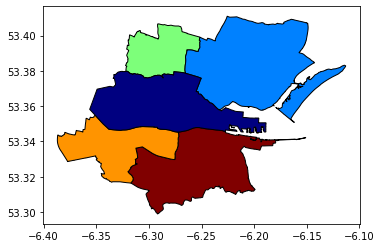

In [50]:
# Plot the 5 committee areas of Dublin
dublin_5areas.plot(column = "Name", cmap = "jet", edgecolor = "black");

In [51]:
# Create a geodataframe based on a dataset prepared above
bike = pd.read_csv("dublin_bike_parking_stands_final.csv")
bp_geometry = gpd.GeoDataFrame(bike, geometry = gpd.points_from_xy(bike.long, bike.lat))
bp_geometry.head()

,stand_type,easting,northing,long,lat,stand_numbers,geometry
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4,POINT (-6.22726 53.34779)
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1,POINT (-6.26513 53.33425)
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2,POINT (-6.24976 53.34495)
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1,POINT (-6.25105 53.34851)
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3,POINT (-6.24227 53.34297)


In [52]:
# Join the two geodataframes
area_geometry = bp_geometry.sjoin(dublin_5areas)
area_geometry.head()  

,stand_type,easting,northing,long,lat,stand_numbers,geometry,index_right,Name
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4,POINT (-6.22726 53.34779),4,CENTRAL
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1,POINT (-6.25105 53.34851),4,CENTRAL
5,Sheffield Stand,315786.687,234487.924,-6.262076,53.348178,2,POINT (-6.26208 53.34818),4,CENTRAL
6,Sheffield Stand,316463.739,234911.200,-6.251759,53.351830,3,POINT (-6.25176 53.35183),4,CENTRAL
7,Sheffield Stand,315358.411,235444.966,-6.268155,53.356866,3,POINT (-6.26816 53.35687),4,CENTRAL


In [53]:
# Rearrange the joined geodataframe
area_geometry.drop(columns = {"easting", "northing", "index_right"}, inplace = True)
area_geometry.rename(columns = {"Name":"area"}, inplace=True)
area_geometry.head()

,stand_type,long,lat,stand_numbers,geometry,area
0,Sheffield Stand,-6.227256,53.347793,4,POINT (-6.22726 53.34779),CENTRAL
3,Sheffield Stand,-6.251047,53.348514,1,POINT (-6.25105 53.34851),CENTRAL
5,Sheffield Stand,-6.262076,53.348178,2,POINT (-6.26208 53.34818),CENTRAL
6,Sheffield Stand,-6.251759,53.351830,3,POINT (-6.25176 53.35183),CENTRAL
7,Sheffield Stand,-6.268155,53.356866,3,POINT (-6.26816 53.35687),CENTRAL


In [54]:
# Write into a geojson file for future reference
area_geometry.to_file("dublin_bike_parking_stands.geojson", driver = "GeoJSON")  

### 2. EDA

In [55]:
# Re-read firstly saved dataset
bp_final = pd.read_csv("dublin_bike_parking_stands_final.csv")

In [56]:
# Overview of the statistics of numeric data
bp_final.describe()

,easting,northing,long,lat,stand_numbers
count,9.360000e+02,936.000000,936.000000,936.000000,936.000000
mean,3.188461e+05,234259.146073,-6.222243,53.338613,5.929487
std,9.291506e+04,1604.292475,1.210941,0.229736,6.294157
min,3.084301e+05,229372.000000,-6.373332,46.331202,1.000000
25%,3.151364e+05,233365.512000,-6.271998,53.338002,4.000000
50%,3.157096e+05,234124.392500,-6.263309,53.344813,5.000000
75%,3.164988e+05,234831.379000,-6.251631,53.351273,7.000000
max,3.157997e+06,240413.000000,30.777691,53.400065,166.000000


In [57]:
# Overview of the statistics of categorical data
bp_final.describe(include = object)

,stand_type
count,936
unique,7
top,Sheffield Stand
freq,845


- *Overview of some of the infomation in the joined geodataframe, i.e. area_geometry.*

In [58]:
area_geometry["stand_type"].value_counts()

Sheffield Stand                 842
Hoops                            49
Stainless Steel Curved           22
Railing                          14
Temporary Racks                   4
Sheffield Stand +Cargo Stand      1
Cargo bike stands                 1
Name: stand_type, dtype: int64

In [59]:
area_geometry["area"].value_counts()

SOUTH EAST       437
CENTRAL          317
SOUTH CENTRAL    107
NORTH CENTRAL     60
NORTH WEST        12
Name: area, dtype: int64

In [60]:
area_geometry["stand_numbers"].min(), area_geometry["stand_numbers"].max()

(1, 166)

#### 2.1 General visualisation

- **Install DataPrep for general visualisation.**

In [61]:
pip install -U dataprep

Note: you may need to restart the kernel to use updated packages.


In [62]:
# Import library for interactive plotting
# also getting insights to plot using matplotlib and seaborns for report
from dataprep.eda import plot

  0%|                                                                                          | 0/323 [00:00<…


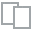
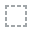
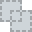
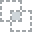
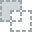
...
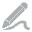
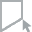
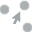
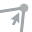
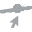

In [63]:
# Plot the whole dataframe
plot(bp_final)

  0%|                                                                                           | 0/76 [00:00<…


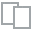
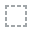
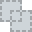
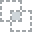
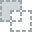
...
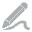
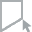
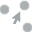
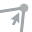
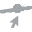

In [64]:
# overview of the statistics of column "stand_type" in the whole dataframe
plot(bp_final, "stand_type")

  0%|                                                                                          | 0/122 [00:00<…


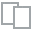
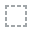
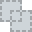
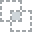
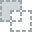
...
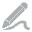
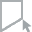
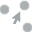
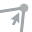
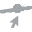

In [65]:
# overview of the statistics of stand_numbers in the whole dataframe
plot(bp_final, "stand_numbers")

  0%|                                                                                           | 0/41 [00:00<…


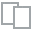
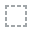
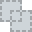
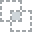
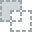
...
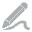
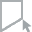
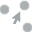
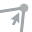
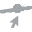

In [66]:
# View the relationship between stand_type and stand_numbers
plot(bp_final, "stand_type", "stand_numbers")


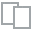
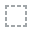
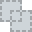
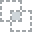
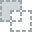
...
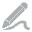
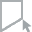
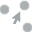
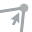
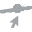

In [67]:
# Check correlation between each column
from dataprep.eda import plot_correlation
plot_correlation(bp_final)

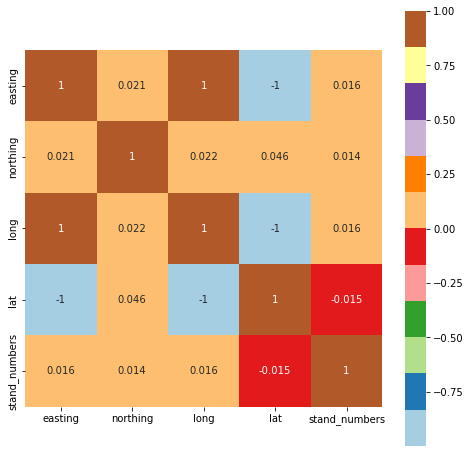

In [68]:
# correlation visually
corrmat = bp_final.corr()
f, ax = plt.subplots(figsize = (8, 8))
fig1 = sns.heatmap(corrmat, vmax = 1, cmap = "Paired", square = True, annot = True);

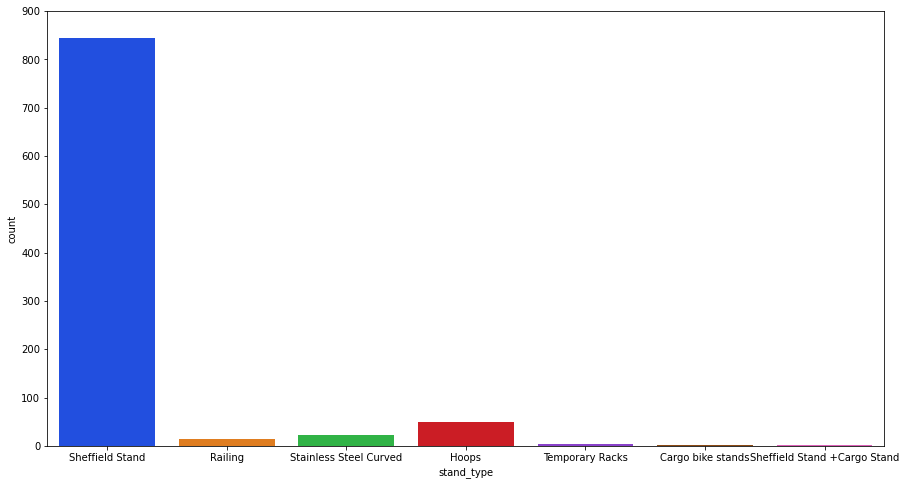

In [69]:
# Plot the count numbers of each type of bike parking stand
f, ax = plt.subplots(figsize=(15, 8))
fig2 = sns.countplot(bp_final["stand_type"], palette = "bright")
fig2.axis(ymin = 0, ymax = 900);

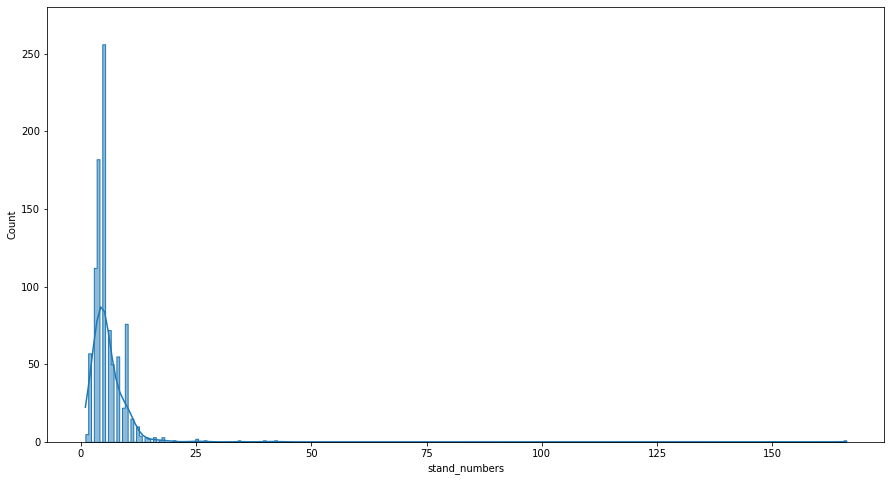

In [70]:
# Plot the count numbers of each type of bike parking stand
f, ax = plt.subplots(figsize = (15, 8))
fig3 = sns.histplot(bp_final["stand_numbers"],
                    kde = True,
                    element = "step")
fig3.axis(ymin = 0, ymax = 280);

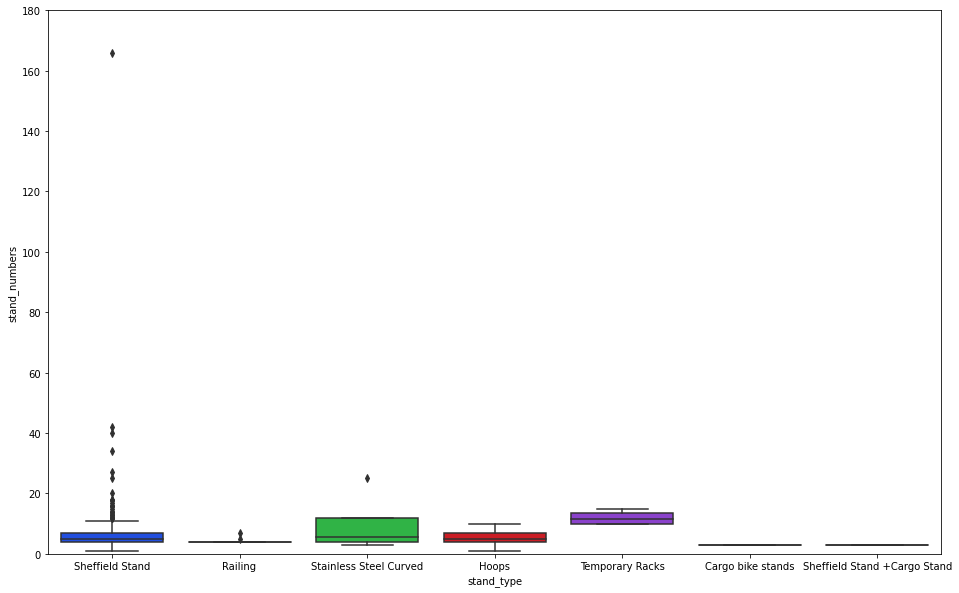

In [71]:
f, ax = plt.subplots(figsize = (16, 10))
fig4 = sns.boxplot(x = "stand_type", y = "stand_numbers", data = bp_final, palette = "bright")
fig4.axis(ymin = 0, ymax = 180);

In [72]:
area_geometry["area"].value_counts()

SOUTH EAST       437
CENTRAL          317
SOUTH CENTRAL    107
NORTH CENTRAL     60
NORTH WEST        12
Name: area, dtype: int64

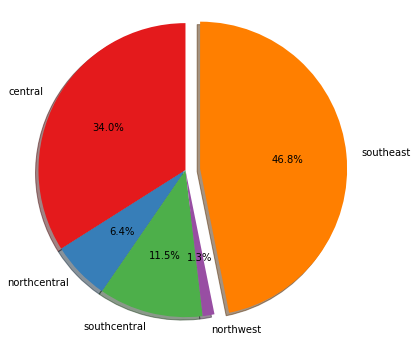

In [73]:
# Create a pie chart based on the value counts in area_geometry
labels = "central", "northcentral", "southcentral", "northwest", "southeast"
sizes = [317, 60, 107, 12, 437]
explode = (0, 0, 0, 0, 0.1)  # only "explode" the 2nd slice (i.e. 'Hogs')
colors = ["#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00"]
f, ax = plt.subplots(figsize = (6, 6))
ax.pie(sizes, explode = explode, labels = labels, autopct='%1.1f%%',
        shadow = True, startangle = 90, colors = colors)
ax.axis("equal")
plt.show()

#### 2.2 Statistical analysis

In [74]:
print("Mean: " + str(bp_final["stand_numbers"].mean()))
print("Standard deviation: " + str(bp_final["stand_numbers"].std()))
print("Maximum: " + str(bp_final["stand_numbers"].max()))
print("Minimum: " + str(bp_final["stand_numbers"].min()))

Mean: 5.92948717948718
Standard deviation: 6.294157052280005
Maximum: 166
Minimum: 1


In [75]:
# skewness and kurtosis
print("Skewness: %f" % bp_final["stand_numbers"].skew())
print("Kurtosis: %f" % bp_final["stand_numbers"].kurt())

Skewness: 18.278106
Kurtosis: 450.263434


In [76]:
# Standardising data and show the low and high 10 ranges
from sklearn.preprocessing import StandardScaler
scaled = StandardScaler().fit_transform(bp_final["stand_numbers"][:,np.newaxis]);
low_range = scaled[scaled[:,0].argsort()][:10]
high_range= scaled[scaled[:,0].argsort()][-10:]
print("Outer range (low) of the distribution: ")
print(low_range)
print("\n outer range (high) of the distribution: ")
print(high_range)

Outer range (low) of the distribution: 
[[-0.78360335]
 [-0.78360335]
 [-0.78360335]
 [-0.78360335]
 [-0.78360335]
 [-0.6246409 ]
 [-0.6246409 ]
 [-0.6246409 ]
 [-0.6246409 ]
 [-0.6246409 ]]

 outer range (high) of the distribution: 
[[ 1.91875827]
 [ 1.91875827]
 [ 2.23668317]
 [ 3.03149541]
 [ 3.03149541]
 [ 3.34942031]
 [ 4.46215745]
 [ 5.41593214]
 [ 5.73385704]
 [25.44520066]]


In [77]:
# Import libraries for distributions
from scipy.stats import norm
from scipy.stats import poisson
from scipy import stats
%matplotlib inline

- **Normal distribution**

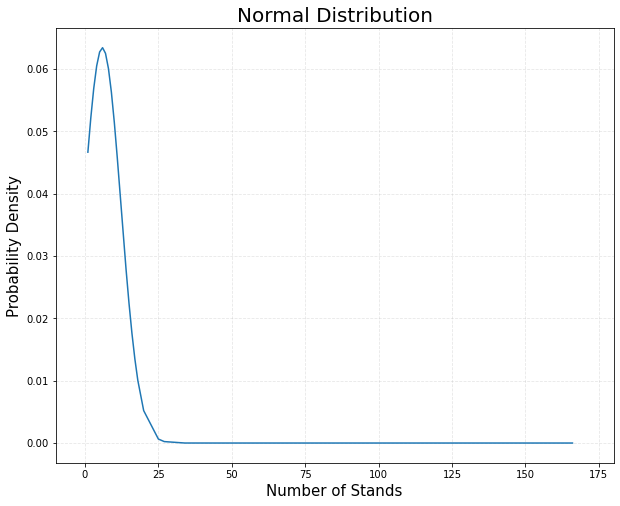

In [78]:
# Calculate mean and standard deviation
bp_mean = np.mean(bp_final["stand_numbers"])
bp_std = np.std(bp_final["stand_numbers"])
 
# Calculate probability density function (PDF)
pdf = stats.norm.pdf(bp_final["stand_numbers"].sort_values(), bp_mean, bp_std)
# Draw graph
plt.figure(figsize = (10, 8))
plt.plot(bp_final["stand_numbers"].sort_values(), pdf)
plt.xlim([-10, 180])  
plt.xlabel("Number of Stands", fontsize = 15)    
plt.ylabel("Probability Density", fontsize = 15)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.grid(True, alpha = 0.3, linestyle = "--")
plt.title("Normal Distribution", fontsize = 20)
plt.show()

- **Continous normal distribution**

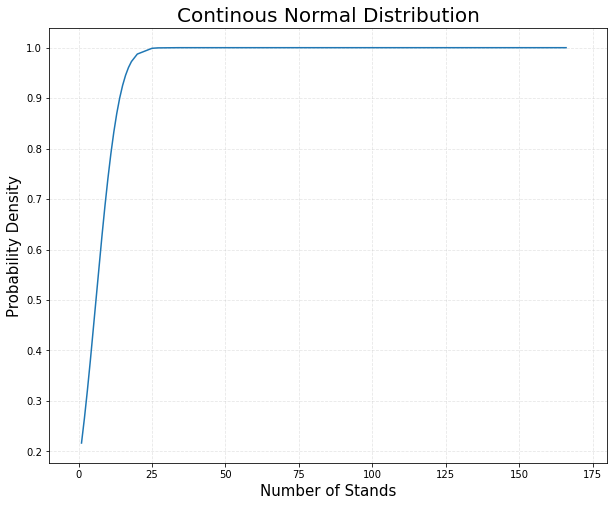

In [79]:
# Calculate mean and standard deviation
bp_mean = np.mean(bp_final["stand_numbers"])
bp_std = np.std(bp_final["stand_numbers"])
 
# Calculate cumulative distribution function (CDF)
cdf = stats.norm.cdf(bp_final["stand_numbers"].sort_values(), bp_mean, bp_std)

# Draw graph
plt.figure(figsize = (10, 8))
plt.plot(bp_final["stand_numbers"].sort_values(), cdf)
plt.xlim([-10, 180])  
plt.xlabel("Number of Stands", fontsize = 15)    
plt.ylabel("Probability Density", fontsize = 15)                
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.grid(True, alpha = 0.3, linestyle = "--")
plt.title("Continous Normal Distribution", fontsize = 20)
plt.show()

- **Poisson distribution using random variates (RVS)**

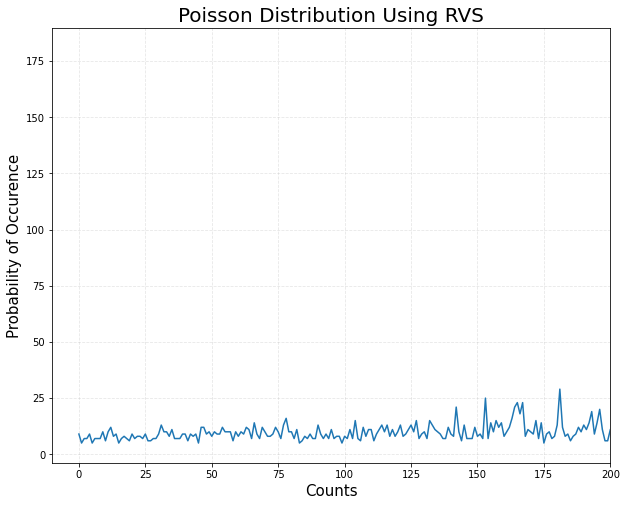

In [80]:
# Caculate k an mu
k = np.array(list(bp_final["stand_numbers"]))
mu = bp_final["stand_numbers"].mean()

# Calculate RVS and draw graph
plt.figure(figsize = (10, 8))
plt.plot(poisson.rvs(k, mu));
plt.xlim([-10, 200])  
plt.xlabel("Counts", fontsize = 15)    
plt.ylabel("Probability of Occurence", fontsize = 15)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.grid(True, alpha = 0.3, linestyle = "--")
plt.title("Poisson Distribution Using RVS", fontsize = 20)
plt.show()

- **Poisson distribution using probability mass function (PMF)**

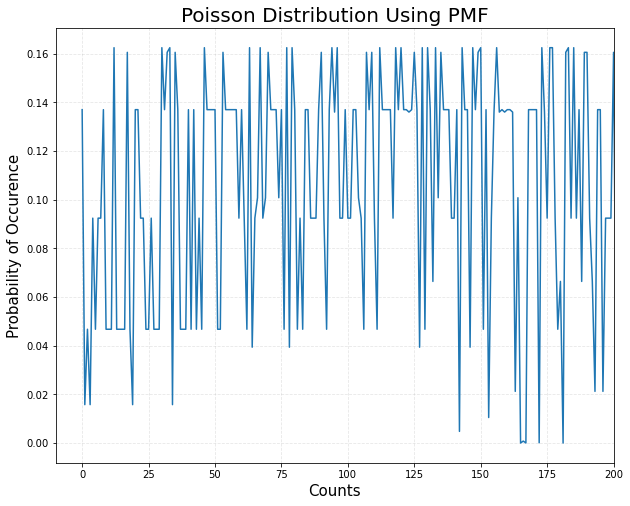

In [81]:
# Caculate k an mu
k = np.array(list(bp_final["stand_numbers"]))
mu = bp_final["stand_numbers"].mean()

# Calculate PMF and draw graph
plt.figure(figsize = (10, 8))
plt.plot(poisson.pmf(k, mu));
plt.xlim([-10, 200])  
plt.xlabel("Counts", fontsize = 15)    
plt.ylabel("Probability of Occurence", fontsize = 15)                
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.grid(True, alpha = 0.3, linestyle = "--")
plt.title("Poisson Distribution Using PMF", fontsize = 20)
plt.show()

- **Poisson distribution using cumulative distribution function (CDF)** 

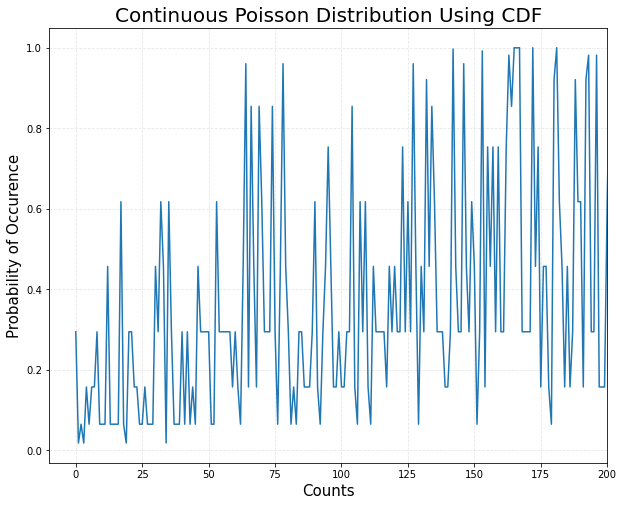

In [82]:
# Caculate k an mu
k = np.array(list(bp_final["stand_numbers"]))
mu = bp_final["stand_numbers"].mean()

# Calculate CDF and draw graph
plt.figure(figsize = (10, 8))
plt.plot(poisson.cdf(k, mu));
plt.xlim([-10, 200])  
plt.xlabel("Counts", fontsize = 15)    
plt.ylabel("Probability of Occurence", fontsize = 15)                
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.grid(True, alpha = 0.3, linestyle = "--")
plt.title("Continuous Poisson Distribution Using CDF", fontsize = 20)
plt.show()

#### 2.3 Interactive visualisation

In [83]:
# Re-read secondly saved dataset which contains location information for interactive visualisation
# This way is more convenient since one of the above cells takes long time to run
bp_final = pd.read_csv("dublin_bike_parking_stands_with_addresses.csv")
bp_final

,stand_type,easting,northing,long,lat,stand_numbers,geom,stand_location
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4,"53.34779326636702, -6.227255782056404","North Docklands, North Wall, North Dock B ED, ..."
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1,"53.334248439303025, -6.265133791780888","39, Camden Street Lower, Saint Kevin's ED, Dub..."
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2,"53.344948684334575, -6.2497608135882246","HSE Primary Care Centre, Mark's Lane, Mansion ..."
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1,"53.34851376066773, -6.251046948776474","IFSC House, Custom House Quay, North Dock C ED..."
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3,"53.342965466086866, -6.242268049500275","Saint Andrew's Resource Centre, 114-116, Pears..."
...,...,...,...,...,...,...,...,...
931,Sheffield Stand,316302.000,233262.000,-6.254792,53.337055,4,"53.33705477444269, -6.254791959130133","Royal Hibernian Academy, 15, Ely Place Upper, ..."
932,Sheffield Stand,315695.000,238310.000,-6.262055,53.382523,10,"53.38252295625358, -6.2620552529215505","Hampstead Avenue, Whitehall A ED, Dublin, Dubl..."
933,Sheffield Stand,314313.000,234658.000,-6.284133,53.350025,4,"53.35002515078593, -6.284132854857711","1, Viking Place, Oxmantown, Arran Quay E ED, D..."
934,Sheffield Stand,309975.000,233713.000,-6.349573,53.342457,5,"53.34245666473957, -6.34957304747032","Church of Assumption, Ballyfermot Road, Ballyf..."


- **Install folium to embed maps in python for interactive visualisation.**

In [84]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [85]:
# Import the library
import folium

In [86]:
# Caculating the location centre 
location_centre = [bp_final["lat"].mean(), bp_final["long"].mean()]
location_centre

[53.338613111779125, -6.222242507453517]

In [87]:
# Embed openstreetmap (default tiles) onto python, locating the centre, i.e. Dublin city
my_map = folium.Map(location = location_centre, zoom_start = 11)

# Insert plugin that shows coordinate information while moving mouse around the map
from folium.plugins import MousePosition
formatter = "function(num) {return L.Util.formatNum(num, 4) + ' º ';};"
plugin_hover = MousePosition(position = "topright", separator = " | ", prefix = "Latitude|Longitude:", 
                             empty_string = "Mouse Position", lng_first = False, num_digits = 20, 
                             lat_formatter = formatter, lng_formatter = formatter)
my_map.add_child(plugin_hover)

# Display map
my_map

- ***Mark map with the locations of each bike parking stand across Dublin.***

In [88]:
# Plot every bike parking stand to the interactive map, at first glance
for i in range(0, len(bp_final)):
    folium.Marker(
        location = [bp_final.iloc[i]["lat"], bp_final.iloc[i]["long"]]).add_to(my_map)
my_map

In [89]:
# Re-check the 7 types of bike parking stands
bp_final["stand_type"].unique()

array(['Sheffield Stand', 'Railing', 'Stainless Steel Curved', 'Hoops',
       'Temporary Racks', 'Cargo bike stands',
       'Sheffield Stand +Cargo Stand'], dtype=object)

In [90]:
# Create a function to define the colors for each stand type
def select_marker_color(row):
    if row["stand_type"] == "Sheffield Stand":
        return "blue"
    elif row["stand_type"] == "Railing":
        return "red"
    elif row["stand_type"] == "Stainless Steel Curved":
        return "green"
    elif row["stand_type"] == "Hoops":
        return "purple"
    elif row["stand_type"] == "Temporary Racks":
        return "orange"
    elif row["stand_type"] == "Cargo bike stands":
        return "pink"
    else:
        return "beige"

In [91]:
# Apply the colors for improving popups of the Marker function
bp_final["color"] = bp_final.apply(select_marker_color, axis = 1)
bp_final

,stand_type,easting,northing,long,lat,stand_numbers,geom,stand_location,color
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4,"53.34779326636702, -6.227255782056404","North Docklands, North Wall, North Dock B ED, ...",blue
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1,"53.334248439303025, -6.265133791780888","39, Camden Street Lower, Saint Kevin's ED, Dub...",blue
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2,"53.344948684334575, -6.2497608135882246","HSE Primary Care Centre, Mark's Lane, Mansion ...",blue
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1,"53.34851376066773, -6.251046948776474","IFSC House, Custom House Quay, North Dock C ED...",blue
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3,"53.342965466086866, -6.242268049500275","Saint Andrew's Resource Centre, 114-116, Pears...",blue
...,...,...,...,...,...,...,...,...,...
931,Sheffield Stand,316302.000,233262.000,-6.254792,53.337055,4,"53.33705477444269, -6.254791959130133","Royal Hibernian Academy, 15, Ely Place Upper, ...",blue
932,Sheffield Stand,315695.000,238310.000,-6.262055,53.382523,10,"53.38252295625358, -6.2620552529215505","Hampstead Avenue, Whitehall A ED, Dublin, Dubl...",blue
933,Sheffield Stand,314313.000,234658.000,-6.284133,53.350025,4,"53.35002515078593, -6.284132854857711","1, Viking Place, Oxmantown, Arran Quay E ED, D...",blue
934,Sheffield Stand,309975.000,233713.000,-6.349573,53.342457,5,"53.34245666473957, -6.34957304747032","Church of Assumption, Ballyfermot Road, Ballyf...",blue


In [92]:
# Write this dataset into default filepath (for future reference)

bp_final.to_csv("dublin_bike_parking_stands_mapvisualisation.csv", index = None, header = True)

In [93]:
# Create a function to modify popup box of all the markers
def fancy_html(row):
    i = row
    stand_type = bp_final["stand_type"].iloc[i]
    stand_numbers = bp_final["stand_numbers"].iloc[i]
    address = bp_final["stand_location"].iloc[i]
    
    left_col_colour = "#addd8e"
    right_col_colour = "#f7fcb9"
    html = """<! DOCTYPE html
<html>

<head>
    <table style = "height: 80px; width: 260px;">
<tbody>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #de2d26;">Stand Type</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(stand_type) + """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #de2d26;">Number of Stands</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(stand_numbers) + """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #de2d26;">Location</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(address) + """
</tr>
</tbody>
</table>
</html>
"""
    return html

In [94]:
#  Finalise Marker function to display the information we intend to show
import branca
for i in range(0, len(bp_final)):
    html = fancy_html(i)
    iframe = branca.element.IFrame(html = html, width = 280, height = 220)
    popup = folium.Popup(iframe, parse_html = True)
    folium.Marker(
        location = [bp_final.iloc[i]["lat"], bp_final.iloc[i]["long"]],
        popup = popup,
        tooltip = bp_final.iloc[i]["stand_type"],
        icon = folium.Icon(color = bp_final.iloc[i]["color"], icon = "fa-solid fa-bicycle", prefix = "fa")).add_to(my_map)
my_map

In [95]:
# Save map with markers
my_map.save("dublin_bike_parking_stands_marker.html")

- ***Generate circles on map according to the distribution ratios of bike parking stands across Dublin.***

In [96]:
# Initialise a map
my_circlemap = folium.Map(location = location_centre, tiles = "cartodbpositron",zoom_start = 12)

# Creat a sequential color variable
import branca.colormap as cm
colormap = cm.LinearColormap(
    ["yellow", "darkgreen", "red"],
    vmin = bp_final["stand_numbers"].min(),
    vmax = bp_final["stand_numbers"].max(),
    caption = "Number of Stands")

# Create the map
for idx, row in bp_final.iterrows():
    folium.Circle(location = [row["lat"], row["long"]],
                 radius = 4*row["stand_numbers"],
                 color = colormap(row["stand_numbers"]),
                 tooltip = "Number of Stands: " + str(row["stand_numbers"])).add_to(my_circlemap)
my_circlemap.add_child(plugin_hover)
my_circlemap

In [97]:
my_circlemap.save("dublin_bike_parking_stands_circle.html")

- ***Create a heatmap to show the distribution of bike parking stands across Dublin. Similar to Circle function.***

In [98]:
# Create a list of the quantities of bike parking stands in each location
parking_heat = bp_final[["lat", "long", "stand_numbers"]].values.tolist()
parking_heat[0]

[53.34779326636702, -6.227255782056404, 4.0]

In [99]:
# Create a heatmap
import folium.plugins as plugins
my_heatmap = folium.Map(location = location_centre, tiles = "cartodbdark_matter", zoom_start = 12)
plugins.HeatMap(parking_heat).add_to(my_heatmap)
my_heatmap

In [100]:
# Save heatmap
my_heatmap.save("dublin_bike_parking_stands_heatmap.html")

- ***Create a choroplethmap to show the density of bike parking stands across the 5 Local Administrative Areas (North West, North Central, Central, South Central and South East) in Dublin.***

In [101]:
# Display the 5 areas
dublin_5areas

,Name,geometry
0,NORTH WEST,"POLYGON Z ((-6.30628 53.40145 0.00000, -6.3058..."
1,NORTH CENTRAL,"POLYGON Z ((-6.14532 53.38582 0.00000, -6.1453..."
2,SOUTH EAST,"POLYGON Z ((-6.27841 53.32989 0.00000, -6.2782..."
3,SOUTH CENTRAL,"POLYGON Z ((-6.27203 53.34466 0.00000, -6.2720..."
4,CENTRAL,"POLYGON Z ((-6.29182 53.34741 0.00000, -6.2918..."


In [102]:
# Set index
dublin_5areas_index = dublin_5areas.set_index("Name")
dublin_5areas_index

,geometry
Name,
NORTH WEST,"POLYGON Z ((-6.30628 53.40145 0.00000, -6.3058..."
NORTH CENTRAL,"POLYGON Z ((-6.14532 53.38582 0.00000, -6.1453..."
SOUTH EAST,"POLYGON Z ((-6.27841 53.32989 0.00000, -6.2782..."
SOUTH CENTRAL,"POLYGON Z ((-6.27203 53.34466 0.00000, -6.2720..."
CENTRAL,"POLYGON Z ((-6.29182 53.34741 0.00000, -6.2918..."


In [103]:
# Calculate the areas in squre km
area = round(dublin_5areas_index.geometry.to_crs(epsg = 29902).area/10**6, 1)
area

Name
NORTH WEST       11.0
NORTH CENTRAL    37.0
SOUTH EAST       26.7
SOUTH CENTRAL    16.4
CENTRAL          26.5
dtype: float64

In [104]:
# Check the stand numbers in each area
area_geometry["area"].value_counts()

SOUTH EAST       437
CENTRAL          317
SOUTH CENTRAL    107
NORTH CENTRAL     60
NORTH WEST        12
Name: area, dtype: int64

In [105]:
# Read geojson file
geojson = gpd.read_file("dcc_5committeeareas_2019_2157.geojson")
geojson

,Name,geometry
0,NORTH WEST,"POLYGON Z ((712628.801 740370.193 0.000, 71262..."
1,NORTH CENTRAL,"POLYGON Z ((723376.597 738898.086 0.000, 72337..."
2,SOUTH EAST,"POLYGON Z ((714674.273 732453.119 0.000, 71464..."
3,SOUTH CENTRAL,"POLYGON Z ((715059.495 734107.257 0.000, 71505..."
4,CENTRAL,"POLYGON Z ((713734.291 734380.708 0.000, 71373..."


In [106]:
# Create a geodataframe to show the density of bike parking stands in the 5 committee areas
density = gpd.GeoDataFrame({"name": ["CENTRAL", "NORTH CENTRAL", "SOUTH CENTRAL", "NORTH WEST", "SOUTH EAST"],
                        "stand_numbers": [317, 60, 107, 12, 437], 
                        "area": [26.5, 37.0, 16.4, 11.0, 26.7]})
density["density"] = density["stand_numbers"]/density["area"]
density["geometry"] = geojson["geometry"]
density

,name,stand_numbers,area,density,geometry
0,CENTRAL,317,26.5,11.962264,"POLYGON Z ((712628.801 740370.193 0.000, 71262..."
1,NORTH CENTRAL,60,37.0,1.621622,"POLYGON Z ((723376.597 738898.086 0.000, 72337..."
2,SOUTH CENTRAL,107,16.4,6.524390,"POLYGON Z ((714674.273 732453.119 0.000, 71464..."
3,NORTH WEST,12,11.0,1.090909,"POLYGON Z ((715059.495 734107.257 0.000, 71505..."
4,SOUTH EAST,437,26.7,16.367041,"POLYGON Z ((713734.291 734380.708 0.000, 71373..."


In [107]:
# Create a choroplethmap for the density
my_choroplethmap = folium.Map(location = location_centre, tiles = "cartodbpositron", zoom_start = 11)

folium.Choropleth(
    geo_data = geojson,
    data = density,
    fill_color = "YlGnBu",
    name = "mychoropleth",
    columns = ["name", "density"],
    key_on = "feature.properties.Name",
    fill_opacity = 1.0,
    line_opacity = 0.4,
    legend_name = "Density of Bike Parking Stands across Dublin").add_to(my_choroplethmap)

my_choroplethmap.add_child(plugin_hover)
folium.LayerControl().add_to(my_choroplethmap)
my_choroplethmap

In [108]:
# Save map
my_choroplethmap.save("dublin_bike_parking_stands_choroplethmap_density.html")

### 3. Machine learning

In [109]:
# Read the final data
bp_final = pd.read_csv("dublin_bike_parking_stands_final.csv")
bp_final.head()

,stand_type,easting,northing,long,lat,stand_numbers
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3


In [110]:
# Add area column to it as our dependent variable
bp_final["area"] = area_geometry["area"]
bp_final

,stand_type,easting,northing,long,lat,stand_numbers,area
0,Sheffield Stand,318106.414,234502.185,-6.227256,53.347793,4,CENTRAL
1,Sheffield Stand,315620.753,232932.916,-6.265134,53.334248,1,SOUTH EAST
2,Sheffield Stand,316615.570,234148.652,-6.249761,53.344949,2,SOUTH EAST
3,Sheffield Stand,316520.200,234543.281,-6.251047,53.348514,1,CENTRAL
4,Sheffield Stand,317119.980,233940.217,-6.242268,53.342965,3,SOUTH EAST
...,...,...,...,...,...,...,...
931,Sheffield Stand,316302.000,233262.000,-6.254792,53.337055,4,SOUTH EAST
932,Sheffield Stand,315695.000,238310.000,-6.262055,53.382523,10,NORTH CENTRAL
933,Sheffield Stand,314313.000,234658.000,-6.284133,53.350025,4,CENTRAL
934,Sheffield Stand,309975.000,233713.000,-6.349573,53.342457,5,SOUTH CENTRAL


In [111]:
# Check missing values
bp_final.isnull().sum()

stand_type       0
easting          0
northing         0
long             0
lat              0
stand_numbers    0
area             3
dtype: int64

- **Missing values appeared again since these three stands are not in the polygons of the 5 areas.**

In [112]:
# Drop missing values
bp_final.dropna(inplace = True)

In [113]:
# Check again
bp_final.isnull().sum()

stand_type       0
easting          0
northing         0
long             0
lat              0
stand_numbers    0
area             0
dtype: int64

- **Install category_encoders to encode categorial data.**

In [114]:
pip install category_encoders

In [115]:
# Import library, encode and rearrange
import category_encoders as ce
encoder = ce.OrdinalEncoder(cols = ["stand_type"], return_df = True,
                  mapping=[{"col":"stand_type", "mapping":
                            {"Sheffield Stand": 1, "Railing": 2, "Stainless Steel Curved": 3, "Hoops": 4,
                            "Temporary Racks": 5, "Cargo bike stands": 6, "Sheffield Stand +Cargo Stand": 7}}])

bp_copy = encoder.fit_transform(bp_final)
ml = bp_copy.copy()
ml = ml.drop(columns = {"easting", "northing"})
ml.head(8) # For machine learning

,stand_type,long,lat,stand_numbers,area
0,1,-6.227256,53.347793,4,CENTRAL
1,1,-6.265134,53.334248,1,SOUTH EAST
2,1,-6.249761,53.344949,2,SOUTH EAST
3,1,-6.251047,53.348514,1,CENTRAL
4,1,-6.242268,53.342965,3,SOUTH EAST
5,1,-6.262076,53.348178,2,CENTRAL
6,1,-6.251759,53.351830,3,CENTRAL
7,1,-6.268155,53.356866,3,CENTRAL


In [116]:
# Extract the values for machine learning, X is independent variables, y is dependent variable
Xnames = ["stand_type", "long", "lat", "stand_numbers"]
X = ml[Xnames].values
y = ml["area"].values

#### 3.1 KNN model

- ***Without scaling***

In [117]:
# Split the data into two parts, one for training, one for testing
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 45)

In [118]:
# Check the shape of splitted data
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((699, 4), (234, 4), (699,), (234,))

In [119]:
# Import model
from sklearn.neighbors import KNeighborsClassifier

# Create a range of 20 neighbors for testing and find the best k number
neighbors = np.arange(1, 20)                 
train_accuracy = np.zeros(len(neighbors)) 
test_accuracy = np.zeros(len(neighbors))
print(neighbors, train_accuracy, test_accuracy)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19] [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.] [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [120]:
# Use iteration function to show the accuracies of each k number in trained and tested sample
for i,k in enumerate(neighbors):  
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X_train, y_train)
    train_accuracy[i] = knn.score(X_train, y_train)
    test_accuracy[i] = knn.score(X_test, y_test)
print(neighbors, train_accuracy, test_accuracy)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19] [1.         0.92131617 0.91559371 0.90414878 0.88268956 0.86266094
 0.86981402 0.84549356 0.84692418 0.8397711  0.82546495 0.83118741
 0.81974249 0.8211731  0.79828326 0.80400572 0.79828326 0.80257511
 0.78111588] [0.84188034 0.83760684 0.77777778 0.78205128 0.74358974 0.75641026
 0.76068376 0.75213675 0.75641026 0.74358974 0.74358974 0.75213675
 0.75213675 0.74786325 0.74358974 0.75213675 0.75641026 0.73504274
 0.75641026]


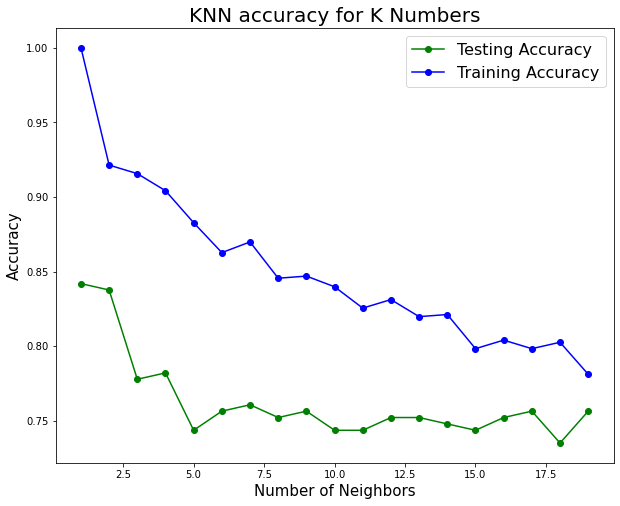

In [121]:
# Plot the accuracies
plt.figure(figsize = (10, 8))
plt.title("KNN accuracy for K Numbers", fontsize = 20)
plt.plot(neighbors, test_accuracy, label = "Testing Accuracy", marker = "o", color = "green")
plt.plot(neighbors, train_accuracy, label = "Training Accuracy", marker = "o", color = "blue")
plt.legend(prop = {"size": 16})
plt.xlabel("Number of Neighbors", fontsize = 15)
plt.ylabel("Accuracy", fontsize = 15)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.show()

In [122]:
# Numbers of independent features
X_col = ml[Xnames]
len(X_col.columns)

4

In [123]:
# According to the graph and chose k=18 as our n_neighbors
knn = KNeighborsClassifier(n_neighbors = 18)
knn.fit(X_train, y_train)

# Excute Recursive Feature Elimination
from sklearn.feature_selection import RFE
rfe = RFE(knn, n_features_to_select = 4)             
rfe = rfe.fit(X_train, y_train)

# Calculate accuracies
train_accuracy = knn.score(X_train, y_train)
test_accuracy = knn.score(X_test, y_test)

In [124]:
# tuples of (feature name, whether selected, ranking)
list(zip(X_col.columns, rfe.support_, rfe.ranking_))

[('stand_type', True, 1),
 ('long', True, 1),
 ('lat', True, 1),
 ('stand_numbers', True, 1)]

In [125]:
# Display the accuracies
print(train_accuracy, test_accuracy)

0.8025751072961373 0.7350427350427351


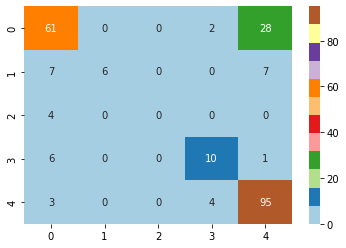

In [126]:
# Check confusion matrix
from sklearn.metrics import confusion_matrix
y_pred = knn.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot = True, cmap = "Paired");

In [127]:
# Show the classification report
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

               precision    recall  f1-score   support

      CENTRAL       0.75      0.67      0.71        91
NORTH CENTRAL       1.00      0.30      0.46        20
   NORTH WEST       0.00      0.00      0.00         4
SOUTH CENTRAL       0.62      0.59      0.61        17
   SOUTH EAST       0.73      0.93      0.82       102

     accuracy                           0.74       234
    macro avg       0.62      0.50      0.52       234
 weighted avg       0.74      0.74      0.71       234



In [128]:
from sklearn import metrics
print("Accuracy without scaling by KNN model: ", round(metrics.accuracy_score(y_test, y_pred), 2))

Accuracy without scaling by KNN model:  0.74


- ***Use standardscaler and excute same procedures above***

In [129]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [130]:
from sklearn.model_selection import train_test_split
X1_train, X1_test, y1_train, y1_test = train_test_split(X_scaled, y, test_size = 0.25, random_state = 45)

In [131]:
from sklearn.neighbors import KNeighborsClassifier
neighbors = np.arange(1, 20)                 
train_accuracy = np.zeros(len(neighbors)) 
test_accuracy = np.zeros(len(neighbors))
print(neighbors, train_accuracy, test_accuracy)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19] [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.] [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [132]:
for i,k in enumerate(neighbors):  
    knn = KNeighborsClassifier(n_neighbors = k)
    knn.fit(X1_train, y1_train)
    train_accuracy[i] = knn.score(X1_train, y1_train)
    test_accuracy[i] = knn.score(X1_test, y1_test)
print(neighbors, train_accuracy, test_accuracy)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19] [1.         0.96566524 0.96423462 0.96137339 0.96280401 0.95851216
 0.95135908 0.94277539 0.94277539 0.93562232 0.94134478 0.93276109
 0.93133047 0.93562232 0.92274678 0.92274678 0.9241774  0.91845494
 0.91845494] [0.92735043 0.93589744 0.93162393 0.94871795 0.94444444 0.94444444
 0.93589744 0.92735043 0.92307692 0.92307692 0.92735043 0.91880342
 0.91452991 0.91025641 0.8974359  0.89316239 0.88034188 0.88461538
 0.87179487]


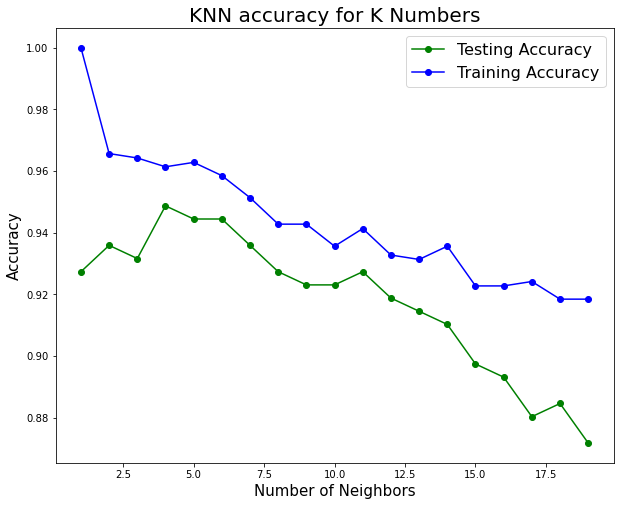

In [133]:
plt.figure(figsize = (10, 8))
plt.title("KNN accuracy for K Numbers", fontsize = 20)
plt.plot(neighbors, test_accuracy, label = "Testing Accuracy", marker = "o", color = "green")
plt.plot(neighbors, train_accuracy, label = "Training Accuracy", marker = "o", color = "blue")
plt.legend(prop = {"size": 16})
plt.xlabel("Number of Neighbors", fontsize = 15)
plt.ylabel("Accuracy", fontsize = 15)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.show()

In [134]:
# k=4/6 is our best options in this case
knn = KNeighborsClassifier(n_neighbors = 6)
knn.fit(X1_train, y1_train)
train_accuracy = knn.score(X1_train, y1_train)
test_accuracy = knn.score(X1_test, y1_test)
print(train_accuracy, test_accuracy)

0.9585121602288984 0.9444444444444444


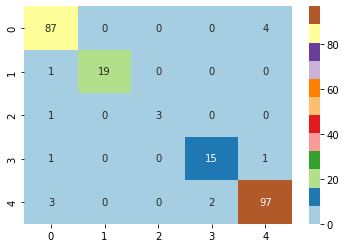

In [135]:
from sklearn.metrics import confusion_matrix
y1_pred = knn.predict(X1_test)
cm1 = confusion_matrix(y1_test, y1_pred)
sns.heatmap(cm1, annot = True, cmap = "Paired");

In [136]:
from sklearn.metrics import classification_report
print(classification_report(y1_test, y1_pred))

               precision    recall  f1-score   support

      CENTRAL       0.94      0.96      0.95        91
NORTH CENTRAL       1.00      0.95      0.97        20
   NORTH WEST       1.00      0.75      0.86         4
SOUTH CENTRAL       0.88      0.88      0.88        17
   SOUTH EAST       0.95      0.95      0.95       102

     accuracy                           0.94       234
    macro avg       0.95      0.90      0.92       234
 weighted avg       0.94      0.94      0.94       234



In [137]:
from sklearn import metrics
print("Accuracy using standardscale with KNN model: ", round(metrics.accuracy_score(y1_test, y1_pred), 2))

Accuracy using standardscale with KNN model:  0.94


#### 3.2 Non-linear SVM

In [138]:
# Import model and libraries
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import scale

- ***Brief look without scaling***

In [139]:
# Import model and split data
from sklearn.model_selection import train_test_split
X2_train, X2_test, y2_train, y2_test = train_test_split(X, y, test_size = 0.25, random_state = 45)

In [140]:
# Create a svm model built on Gaussian Radial Basis Function (rdf) kernel
svm = SVC(kernel = "rbf")

# Train and test the data
svm.fit(X2_train, y2_train)
y2_pred = svm.predict(X2_test)

# Check accuracy
print("Accuracy using rdf kernel without scaling: ", round(metrics.accuracy_score(y2_test, y2_pred), 2))

Accuracy using rdf kernel without scaling:  0.44


- ***The accuracy looks low. Now we changed to scaled data.***

In [141]:
from sklearn.model_selection import train_test_split
X3_train, X3_test, y3_train, y3_test = train_test_split(X_scaled, y, test_size = 0.25, random_state = 45)

In [142]:
svm = SVC(kernel = "rbf")
svm.fit(X3_train, y3_train)
y3_pred = svm.predict(X3_test)
print("Accuracy using rdf kernel after standardscaling: ", round(metrics.accuracy_score(y3_test, y3_pred), 2))

Accuracy using rdf kernel after standardscaling:  0.92


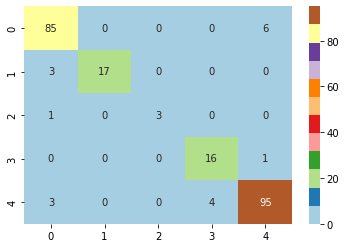

In [143]:
# Plot confusion matrix
cm2 = confusion_matrix(y3_test, y3_pred)
sns.heatmap(cm2, annot = True, cmap = "Paired");

In [144]:
# Show classification report
from sklearn.metrics import classification_report
print(classification_report(y3_test, y3_pred))

               precision    recall  f1-score   support

      CENTRAL       0.92      0.93      0.93        91
NORTH CENTRAL       1.00      0.85      0.92        20
   NORTH WEST       1.00      0.75      0.86         4
SOUTH CENTRAL       0.80      0.94      0.86        17
   SOUTH EAST       0.93      0.93      0.93       102

     accuracy                           0.92       234
    macro avg       0.93      0.88      0.90       234
 weighted avg       0.93      0.92      0.92       234



- Cross validate and find the best C and gamma numbers

In [145]:
# Create a KFold object with 5 splits 
folds = KFold(n_splits = 6, shuffle = True, random_state = 45)

# Specify range of hyperparameters
# Set the parameters by cross-validation
hyper_params = [{"gamma": [1e-2, 1e-3, 1e-4],
                     "C": [1, 10, 100, 1000]}]


# Specify model
model = SVC(kernel = "rbf")

# Set up GridSearchCV() and fit
model_cv = GridSearchCV(estimator = model, 
                        param_grid = hyper_params, 
                        scoring = "accuracy", 
                        cv = folds, 
                        verbose = 1,
                        return_train_score = True)
model_cv.fit(X2_train, y2_train)

Fitting 6 folds for each of 12 candidates, totalling 72 fits


GridSearchCV(cv=KFold(n_splits=6, random_state=45, shuffle=True),
             estimator=SVC(),
             param_grid=[{'C': [1, 10, 100, 1000],
                          'gamma': [0.01, 0.001, 0.0001]}],
             return_train_score=True, scoring='accuracy', verbose=1)

In [146]:
# cv results
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   mean_fit_time       12 non-null     float64
 1   std_fit_time        12 non-null     float64
 2   mean_score_time     12 non-null     float64
 3   std_score_time      12 non-null     float64
 4   param_C             12 non-null     object 
 5   param_gamma         12 non-null     object 
 6   params              12 non-null     object 
 7   split0_test_score   12 non-null     float64
 8   split1_test_score   12 non-null     float64
 9   split2_test_score   12 non-null     float64
 10  split3_test_score   12 non-null     float64
 11  split4_test_score   12 non-null     float64
 12  split5_test_score   12 non-null     float64
 13  mean_test_score     12 non-null     float64
 14  std_test_score      12 non-null     float64
 15  rank_test_score     12 non-null     int32  
 16  split0_tra

In [147]:
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_gamma,params,split0_test_score,split1_test_score,split2_test_score,...,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,split5_train_score,mean_train_score,std_train_score
0,0.023004,0.006410,0.010417,0.007366,1,0.01,"{'C': 1, 'gamma': 0.01}",0.57265,0.418803,0.504274,...,0.048335,5,0.465636,0.493127,0.479381,0.485420,0.488851,0.488851,0.483544,0.009034
1,0.018234,0.005820,0.012589,0.009291,1,0.001,"{'C': 1, 'gamma': 0.001}",0.57265,0.427350,0.495726,...,0.046857,6,0.463918,0.493127,0.477663,0.485420,0.487136,0.488851,0.482686,0.009590
2,0.022843,0.006442,0.006709,0.007063,1,0.0001,"{'C': 1, 'gamma': 0.0001}",0.57265,0.427350,0.495726,...,0.046857,6,0.462199,0.489691,0.477663,0.481990,0.487136,0.485420,0.480683,0.009108
3,0.051500,0.011239,0.014855,0.001726,10,0.01,"{'C': 10, 'gamma': 0.01}",0.57265,0.418803,0.495726,...,0.048725,11,0.465636,0.493127,0.479381,0.488851,0.490566,0.488851,0.484402,0.009408
4,0.033422,0.011168,0.018230,0.005820,10,0.001,"{'C': 10, 'gamma': 0.001}",0.57265,0.427350,0.504274,...,0.046587,2,0.465636,0.493127,0.479381,0.485420,0.488851,0.488851,0.483544,0.009034


In [148]:
# Print the optimal accuracy score and hyperparameters
best_score = model_cv.best_score_
best_hyperparams = model_cv.best_params_

print("The best test score is {0} corresponding to hyperparameters {1}".format(best_score, best_hyperparams))

The best test score is 0.6751645544748993 corresponding to hyperparameters {'C': 1000, 'gamma': 0.01}


In [149]:
# Use the best hyperparameter to test
from sklearn.model_selection import train_test_split
X4_train, X4_test, y4_train, y4_test = train_test_split(X_scaled, y, test_size = 0.25, random_state = 45)

svm1 = SVC(kernel = "rbf", C = 1000, gamma = 0.01)
svm1.fit(X4_train, y4_train)
y4_pred = svm1.predict(X4_test)

# Display the accuracy
print("Accuracy using rbf kernel with the best hyperparameters: ", round(metrics.accuracy_score(y4_test, y4_pred), 2))

Accuracy using rbf kernel with the best hyperparameters:  0.94


In [150]:
print(classification_report(y4_test, y4_pred))

               precision    recall  f1-score   support

      CENTRAL       0.96      0.95      0.95        91
NORTH CENTRAL       1.00      0.95      0.97        20
   NORTH WEST       1.00      0.50      0.67         4
SOUTH CENTRAL       0.80      0.94      0.86        17
   SOUTH EAST       0.94      0.95      0.95       102

     accuracy                           0.94       234
    macro avg       0.94      0.86      0.88       234
 weighted avg       0.94      0.94      0.94       234



- ***Brief look using sigmoid kernel***

In [151]:
from sklearn.model_selection import train_test_split
X5_train, X5_test, y5_train, y5_test = train_test_split(X_scaled, y, test_size = 0.25, random_state = 45)

svm2 = SVC(kernel = "sigmoid", C = 1000, gamma = 0.01)
svm2.fit(X5_train, y5_train)
y5_pred = svm1.predict(X5_test)

# Display the accuracy
print("Accuracy using sigmoid kernel: ", round(metrics.accuracy_score(y5_test, y5_pred), 2))

Accuracy using sigmoid kernel:  0.94


### References

- <p> https://colorbrewer2.org/#type=qualitative&scheme=Paired&n=7 <p>
- <p> https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.poisson.html?highlight=poisson#scipy.stats.poisson <p>
- <p> https://fontawesome.com/icons/bicycle?s=solid&f=classic <p>
- <p> https://github.com/PacktPublishing/Machine-Learning-with-Real-World-Projects <p>
- <p> https://geopandas.org/en/stable/index.html <p>
- <p> https://machinelearningmastery.com/knn-imputation-for-missing-values-in-machine-learning/ <p>
- <p> https://matplotlib.org/stable/index.html <p>
- <p> https://pandas.pydata.org/docs/index.html <p>
- <p> https://pyproj4.github.io/pyproj/stable/index.html <p>
- <p> https://python-visualization.github.io/folium/quickstart.html#Getting-Started <p>
- <p> https://scikit-learn.org/stable/ <p>
- <p> https://stackoverflow.com/questions/71287607/how-to-make-a-normal-distribution-graph-from-data-frame-in-python <p>
- <p> https://towardsdatascience.com/reverse-geocoding-in-python-a915acf29eb6 <p>
- <p> https://www.datacamp.com/community/tutorials/introduction-machine-learning-python <p>
- <p> https://www.kaggle.com/code/dabaker/fancy-folium <p>
- <p> Peng, J. et al. (2021) ‘DataPrep.EDA: Task-Centric Exploratory Data Analysis for Statistical Modeling in Python’, in Proceedings of the 2021 International Conference on Management of Data. New York, NY, USA: Association for Computing Machinery (SIGMOD ’21), pp. 2271–2280. Available at: https://doi.org/10.1145/3448016.3457330. <p>